In [262]:
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import IPython.display as ipd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import librosa
import librosa.display
import ast


sns.set_context("notebook", font_scale=1.5)
plt.rcParams['figure.figsize'] = (17, 5)

In [263]:
tracks = pd.read_csv('../data/Final-csvs/smalltracks.csv')

In [264]:
tracks = pd.read_csv('../data/Final-csvs/smalltracks.csv', index_col=0, header=[0, 1])

COLUMNS = [('track', 'tags'), ('album', 'tags'), ('artist', 'tags'),
                   ('track', 'genres'), ('track', 'genres_all')]
for column in COLUMNS:
    tracks[column] = tracks[column].map(ast.literal_eval)

COLUMNS = [('track', 'date_created'), ('track', 'date_recorded'),
                   ('album', 'date_created'), ('album', 'date_released'),
                   ('artist', 'date_created'), ('artist', 'active_year_begin'),
                   ('artist', 'active_year_end')]
for column in COLUMNS:
    tracks[column] = pd.to_datetime(tracks[column])

       
tracks['subset'] = tracks['set']['subset']
COLUMNS = [('track', 'genre_top'), ('track', 'license'),
                   ('album', 'type'), ('album', 'information'),
                   ('artist', 'bio')]
for column in COLUMNS:
    tracks[column] = tracks[column].astype('category')
    
tracks.shape

(8000, 55)

In [265]:
newtracks = tracks['track']

In [266]:
genres = pd.read_csv('../data/Final-csvs/smallgenres.csv')

In [267]:
genres

,genre_id,#tracks,parent,title,top_level
0,2,5271,0,International,2
1,10,13845,0,Pop,10
2,12,32923,0,Rock,12
3,15,34413,0,Electronic,15
4,17,12706,0,Folk,17
5,21,8389,0,Hip-Hop,21
6,38,38154,0,Experimental,38
7,1235,14938,0,Instrumental,1235


In [268]:
ipd.display(tracks['track'].head())


,bit_rate,comments,composer,date_created,date_recorded,duration,favorites,genre_top,genres,genres_all,information,interest,language_code,license,listens,lyricist,number,publisher,tags,title
track_id,,,,,,,,,,,,,,,,,,,,
2,256000,0,NaN,2008-11-26 01:48:12,2008-11-26,168,2,Hip-Hop,[21],[21],NaN,4656,en,Attribution-NonCommercial-ShareAlike 3.0 Inter...,1293,NaN,3,NaN,[],Food
5,256000,0,NaN,2008-11-26 01:48:20,2008-11-26,206,6,Hip-Hop,[21],[21],NaN,1933,en,Attribution-NonCommercial-ShareAlike 3.0 Inter...,1151,NaN,6,NaN,[],This World
10,192000,0,Kurt Vile,2008-11-25 17:49:06,2008-11-26,161,178,Pop,[10],[10],NaN,54881,en,Attribution-NonCommercial-NoDerivatives (aka M...,50135,NaN,1,NaN,[],Freeway
140,128000,0,NaN,2008-11-26 01:44:07,2008-11-26,253,5,Folk,[17],[17],NaN,1593,en,Attribution-Noncommercial-No Derivative Works ...,1299,NaN,2,NaN,[],Queen Of The Wires
141,128000,0,NaN,2008-11-26 01:44:10,2008-11-26,182,1,Folk,[17],[17],NaN,839,en,Attribution-Noncommercial-No Derivative Works ...,725,NaN,4,NaN,[],Ohio


In [269]:
print('{} tracks, {} artists, {} albums, {} genres'.format(
    len(tracks), len(tracks['artist', 'id'].unique()),
    len(tracks['album', 'id'].unique()),
    sum(genres['#tracks'] > 0)))
mean_duration = tracks['track', 'duration'].mean()
print('track duration: {:.0f} days total, {:.0f} seconds average'.format(
    sum(tracks['track', 'duration']) / 3600 / 24,
    mean_duration))

8000 tracks, 2309 artists, 2464 albums, 8 genres
track duration: 21 days total, 229 seconds average


In [270]:
dimensionality = mean_duration * 44000 * 2
print('sample dimensionality: {:.1e}'.format(dimensionality))
print('total size, i.e. number of audio samples: {:.1e}'.format(dimensionality * len(tracks)))

sample dimensionality: 2.0e+07
total size, i.e. number of audio samples: 1.6e+11


In [271]:
for subset in tracks['set', 'subset'].unique():
    indicator = tracks['set', 'subset'] <= subset
    print('{:6} {:6} tracks  {:.1f} days'.format(
        subset, sum(indicator), sum(indicator) * 30 / 3600 / 24))

small    8000 tracks  2.8 days


147066 deleted tracks (largest track_id is 155066)
First track: 2008-11-25 17:49:06


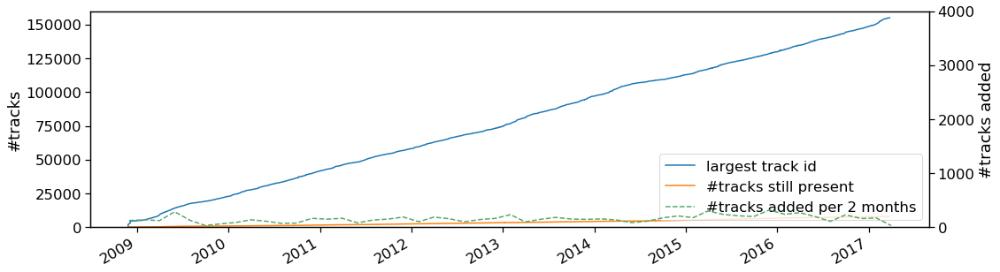

In [272]:
print('{} deleted tracks (largest track_id is {})'.format(tracks.index.max() - len(tracks), tracks.index.max()))
print('First track: {}'.format(tracks['track', 'date_created'].min()))

d = pd.DataFrame(tracks.index, index=tracks['track', 'date_created'].values)
d['indicator'] = 1

fig, ax1 = plt.subplots()
ax2 = ax1.twinx()

d['track_id'].plot(ax=ax1)
d['indicator'].cumsum().plot(ax=ax1)
ax1.set_ylabel('#tracks')
ax1.set_ylim(0, 160000)

(d['indicator'] * -100).plot(ax=ax2, style='r')  # needed for no apparent reason
color = sns.color_palette('deep', 3)[2]
d['indicator'].resample('2M').sum().fillna(0).plot(ax=ax2, style='--', color=color)
ax2.set_ylabel('#tracks added')
ax2.set_ylim(500, 4500)
ax2.set_ylim(0, 4000)
ax2.grid(False)

lns = ax1.get_lines() + [ax2.get_lines()[1]]
ax1.legend(lns, ['largest track id', '#tracks still present', '#tracks added per 2 months'], loc='lower right')

plt.savefig('../figures/growth.pdf')

In [273]:
tracks['track', 'language_code'].value_counts()

en    928
es     21
fr      9
ru      9
bg      6
de      6
sw      5
el      5
pt      5
ar      4
tr      4
cs      2
it      1
Name: (track, language_code), dtype: int64

# Duration Display of Tracks

count    8000.000000
mean      228.841500
std        98.394854
min        60.000000
25%       161.000000
50%       215.000000
75%       279.000000
max       600.000000
Name: (track, duration), dtype: float64

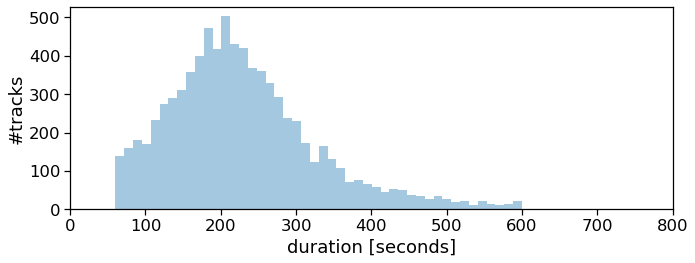

In [274]:
durations = tracks['track', 'duration']
plt.figure(figsize=(10, 4))  # Poster: (7, 3)
p = sns.distplot(durations[durations.values < 800], kde=False, rug=False, hist_kws=dict(alpha=0.4))
p.set_xlabel('duration [seconds]')
p.set_ylabel('#tracks')
p.set_xlim(0, 800)  # Poster: 500
plt.tight_layout()
plt.savefig('../figures/duration_distribution.pdf')

durations.describe()

# Bit Rate

Common bit rates: [320000, 256000, 192000, 128000, 160000]
Average bit rate: 265 kbit/s


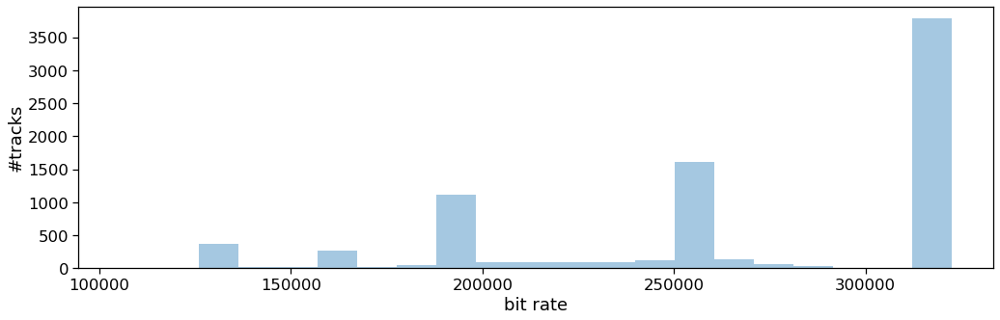

In [275]:
# Uncommon bit rates are VBR encodings.
print('Common bit rates: {}'.format(tracks['track', 'bit_rate'].value_counts().head(5).index.tolist()))
print('Average bit rate: {:.0f} kbit/s'.format(tracks['track', 'bit_rate'].mean()/1000))
p = sns.distplot(tracks['track', 'bit_rate'], kde=False, rug=False)
p.set_xlabel('bit rate')
p.set_ylabel('#tracks');

In [276]:
# Listens, favorites, comments.

def plot(col0, col1, maxval, subplot=None):
    if col0 == 'track':
        d = tracks['track']
    if col0 in ['artist', 'album']:
        d = tracks[col0].drop_duplicates('id')
    if subplot:
        plt.subplot(subplot)
    d = d[col1]
    p = sns.distplot(d[d.values < maxval], kde=False, color='r', hist_kws=dict(alpha=0.4))
    p.set_xlim(-1, maxval)
    p.set_xlabel('# of ' + col1)
    p.set_ylabel('# of ' + col0 + 's')


In [277]:
tracks['track','genre_top']

track_id
2         Hip-Hop
5         Hip-Hop
10            Pop
140          Folk
141          Folk
           ...   
154308    Hip-Hop
154309    Hip-Hop
154413        Pop
154414        Pop
155066    Hip-Hop
Name: (track, genre_top), Length: 8000, dtype: category
Categories (8, object): [Electronic, Experimental, Folk, Hip-Hop, Instrumental, International, Pop, Rock]

In [278]:
newtracks.groupby(['genre_top'])['listens'].sum()

genre_top
Electronic       11390637
Experimental      2354153
Folk              1965550
Hip-Hop           4136863
Instrumental      6570592
International     3460630
Pop               2498791
Rock              5460241
Name: listens, dtype: int64

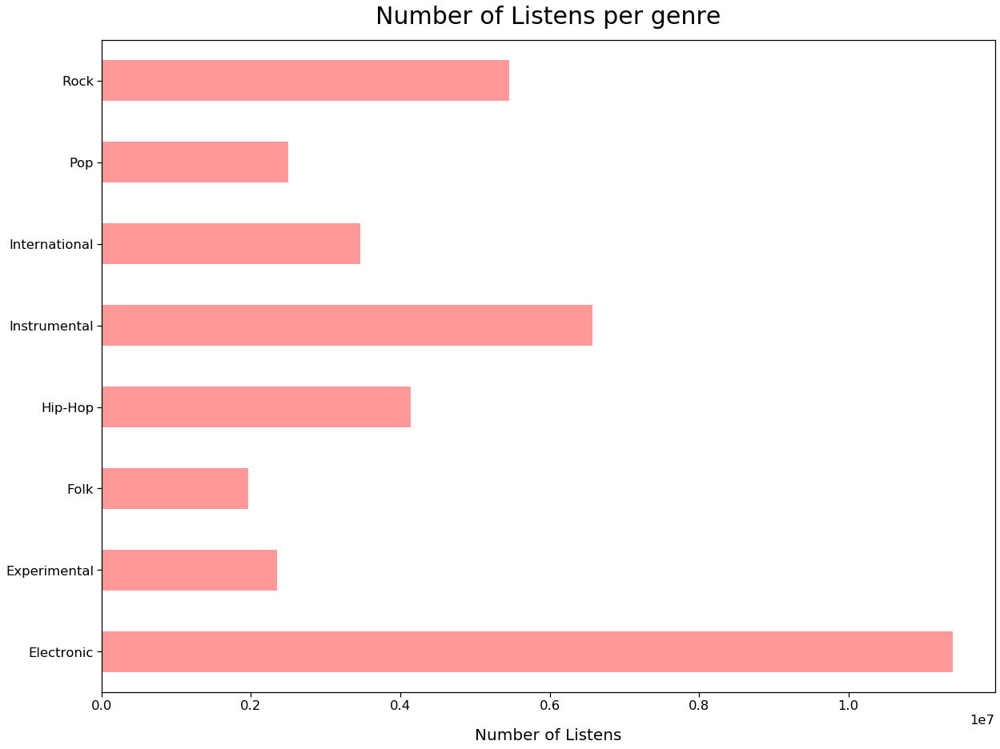

In [302]:
newtracks.groupby(['genre_top'])['listens'].sum().plot(kind = 'barh',figsize=(20,15),color='r',alpha=0.4)
plt.title("Number of Listens per genre",size=30,pad=20)
plt.xlabel('Number of Listens',size=20,labelpad=20);
plt.ylabel("");

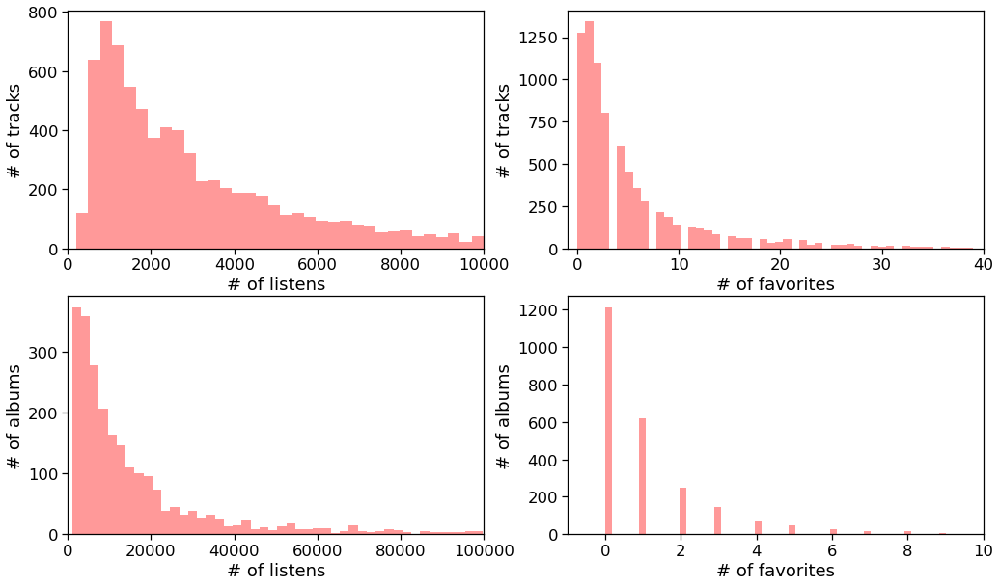

In [281]:
plt.figure(figsize=(17, 10))
plot('track', 'listens', 10e3,221)
plot('track', 'favorites', 40, 222)

plot('album', 'listens', 100e3, 223)
plot('album', 'favorites', 10, 224)

plt.savefig('../figures/listens_favourites_distribution.pdf')


674347

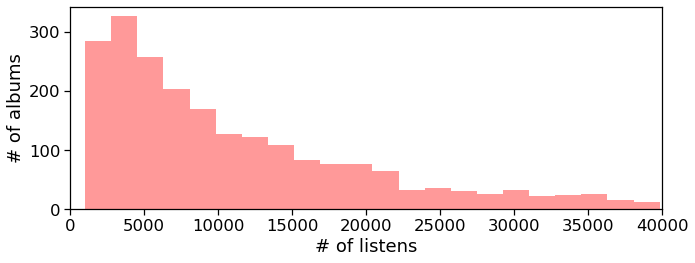

In [282]:
plt.figure(figsize=(10, 4))  
plot('album', 'listens', 40e3) 
plt.tight_layout()
plt.savefig('../figures/listens_distribution.pdf')

tracks['album', 'listens'].max()

In [283]:
# Most listened albums.
tracks['album'].groupby('id').first().sort_values('listens', ascending=False).head(10)

,comments,date_created,date_released,engineer,favorites,information,listens,producer,tags,title,tracks,type
id,,,,,,,,,,,,
8295,10,2011-01-18 12:03:35,2011-01-18,NaN,40,"<p>My newest and most cohesive work, 'Directio...",674347,NaN,"[trip hop, tracks to sync, stellar]",Directionless EP,6,Album
5347,0,2010-01-25 17:34:09,NaT,NaN,12,NaN,595875,NaN,[hip-hop],Free Beats Sel. 3,15,Album
11355,0,2012-03-25 14:15:12,NaT,NaN,15,<p>Traveller's Guide is a user guide. 14 songs...,586634,NaN,"[1intro, tracks to sync, betterwithmusic, pop,...",Traveller's Guide,9,Album
20183,6,2016-03-21 19:54:50,2016-03-22,NaN,28,"<p style=""margin:0px 0px 8px;padding:0px;font-...",468967,NaN,[],Music for TV & Film Vol. 1,42,Album
9620,2,2011-07-15 14:52:26,NaT,NaN,16,<p>Kevin MacLeod borrows from other cultures i...,431787,NaN,[],Global Sampler,9,Album
13915,1,2013-04-03 23:09:04,2013-04-09,NaN,7,<p>A collection of songs that may work as bed ...,386386,NaN,"[bed music, advertising, instrumental, undersc...",Background,35,Album
14588,6,2013-07-04 10:57:00,2013-07-07,NaN,2,<p><strong>C3S :: Ignition Mix</strong> marks ...,383201,NaN,"[country, classic rock, contemporary compositi...",C3S :: Ignition Mix,33,Album
13939,0,2013-04-04 03:47:12,2013-04-30,NaN,7,<p>This collection features compositions that ...,377713,NaN,[],Tender,25,Album
13923,2,2013-04-04 00:01:23,NaT,NaN,9,"<p>A collection of uplifting, percolating, and...",355006,NaN,[],Inspiring,15,Album


# Dates

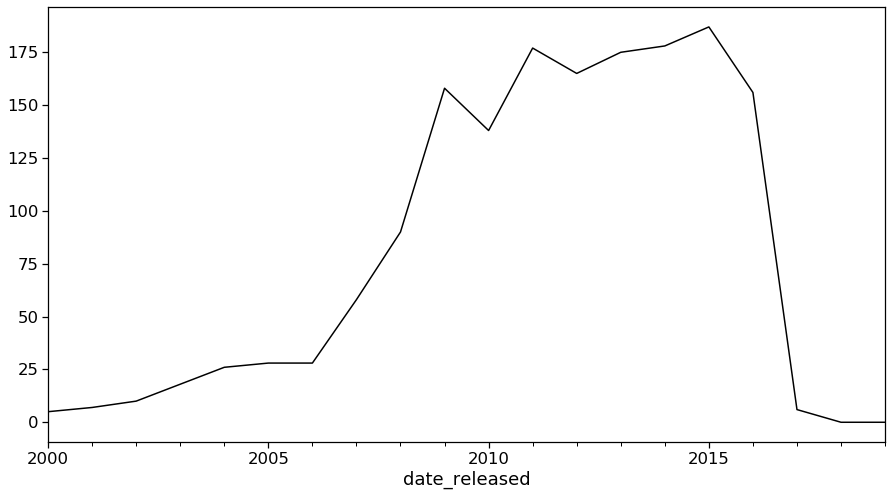

In [67]:
plt.figure(figsize=(15, 8))
d = tracks['album'].drop_duplicates('id')
d = pd.Series(1, index=d['date_released'])
d = d.resample('A').sum().fillna(0)
b = d.index >= pd.to_datetime(2000, format='%Y')
b &= d.index <= pd.to_datetime(2020, format='%Y')
d[b].plot(color='k')



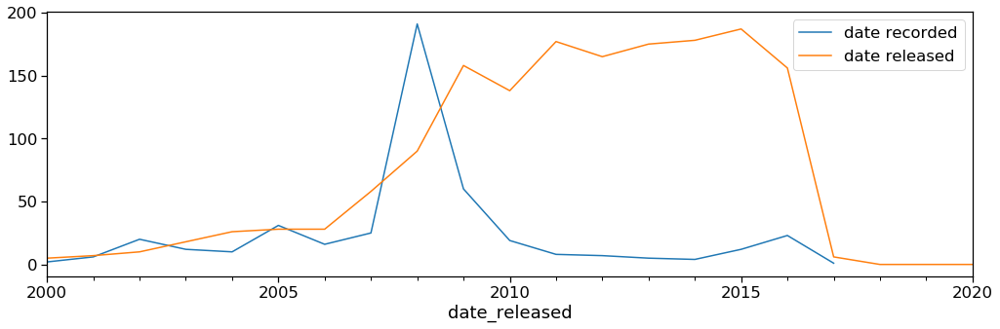

In [68]:
def plot(col0, col1):
    if col0 == 'track':
        d = tracks['track']
    if col0 in ['artist', 'album']:
        d = tracks[col0].drop_duplicates('id')
    d = pd.Series(1, index=d[col1])
    d.resample('A').sum().fillna(0)['2000':'2020'].plot()
plt.figure()
plot('track', 'date_recorded')
plot('album', 'date_released')
plt.legend({'date recorded':'date recorded','date released':'date released'})
plt.show()

In [235]:
genres = list(set(tracks['track','genre_top']))

In [236]:
genres

['Hip-Hop',
 'International',
 'Electronic',
 'Experimental',
 'Pop',
 'Folk',
 'Rock',
 'Instrumental']

In [237]:
for genre in genres:
    print(genre)

Hip-Hop
International
Electronic
Experimental
Pop
Folk
Rock
Instrumental


In [243]:
tracks.loc[tracks['track','genre_top']=='Pop']['track']

,bit_rate,comments,composer,date_created,date_recorded,duration,favorites,genre_top,genres,genres_all,information,interest,language_code,license,listens,lyricist,number,publisher,tags,title
track_id,,,,,,,,,,,,,,,,,,,,
10,192000,0,Kurt Vile,2008-11-25 17:49:06,2008-11-26,161,178,Pop,[10],[10],NaN,54881,en,Attribution-NonCommercial-NoDerivatives (aka M...,50135,NaN,1,NaN,[],Freeway
213,256000,0,Luke Wyland,2008-11-26 01:48:12,2007-01-01,247,10,Pop,[10],[10],NaN,2828,en,Attribution-NonCommercial-ShareAlike 3.0 Inter...,1148,NaN,1,NaN,[],Boute
821,256000,0,NaN,2008-11-26 02:19:52,2008-03-18,200,0,Pop,[10],[10],NaN,1437,en,Attribution-NonCommercial-ShareAlike 3.0 Inter...,438,NaN,1,NaN,[],Sir
822,256000,0,NaN,2008-11-26 02:19:56,2008-03-18,323,0,Pop,[10],[10],NaN,1430,en,Attribution-NonCommercial-ShareAlike 3.0 Inter...,660,NaN,3,NaN,[],Tom & Jerry
1642,256000,0,NaN,2008-11-26 02:59:54,2008-11-26,68,0,Pop,[10],[10],NaN,2458,en,Attribution-Noncommercial-Share Alike 3.0 Unit...,277,NaN,1,NaN,[],Hrz
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153452,320000,0,NaN,2017-02-23 13:37:43,NaT,102,2,Pop,[76],"[10, 76]",NaN,934,NaN,Attribution-NonCommercial,684,NaN,6,NaN,[],Métal Province
153955,192000,0,NaN,2017-02-28 00:50:06,NaT,308,6,Pop,[76],"[10, 76]",NaN,2119,NaN,Attribution-NonCommercial,1394,NaN,11,NaN,[],Not Coming Home
153956,192000,0,NaN,2017-02-28 00:50:32,NaT,298,1,Pop,[76],"[10, 76]",NaN,1773,NaN,Attribution-NonCommercial,1412,NaN,12,NaN,[],Border Collie


In [257]:
for genre in genres:
    d = tracks.loc[tracks['track','genre_top']==genre]['track']
    d = pd.Series(1, index=d['date_recorded'])
    d.resample('A').sum().fillna(0)['2000':'2020']

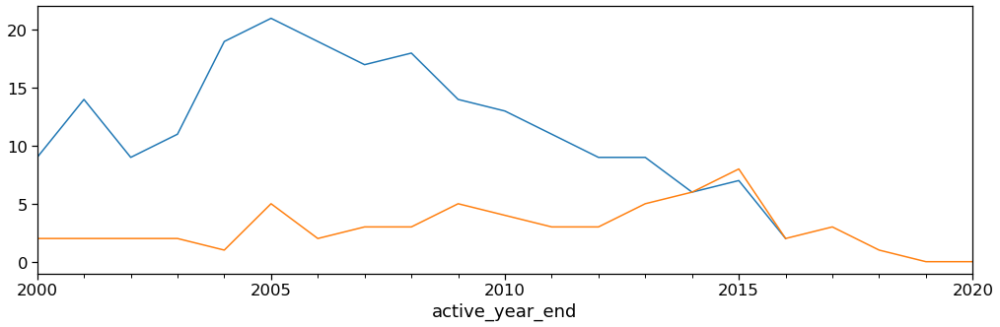

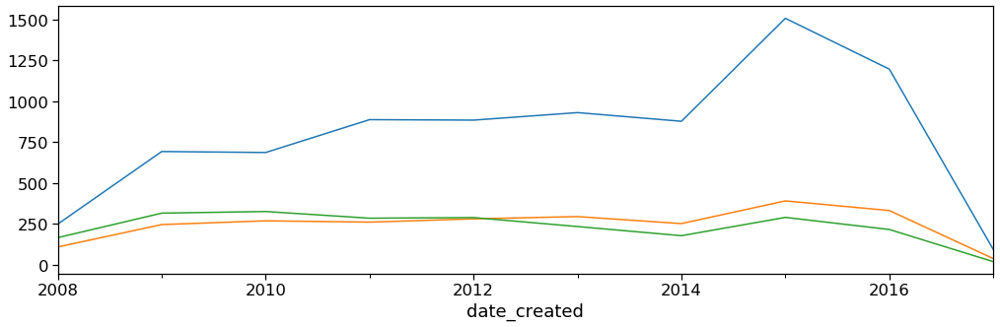

In [69]:

plt.figure()
plot('artist', 'active_year_begin')
plot('artist', 'active_year_end')

plt.figure()
plot('track', 'date_created')
plot('album', 'date_created')
plot('artist', 'date_created')

(1930, 2021)

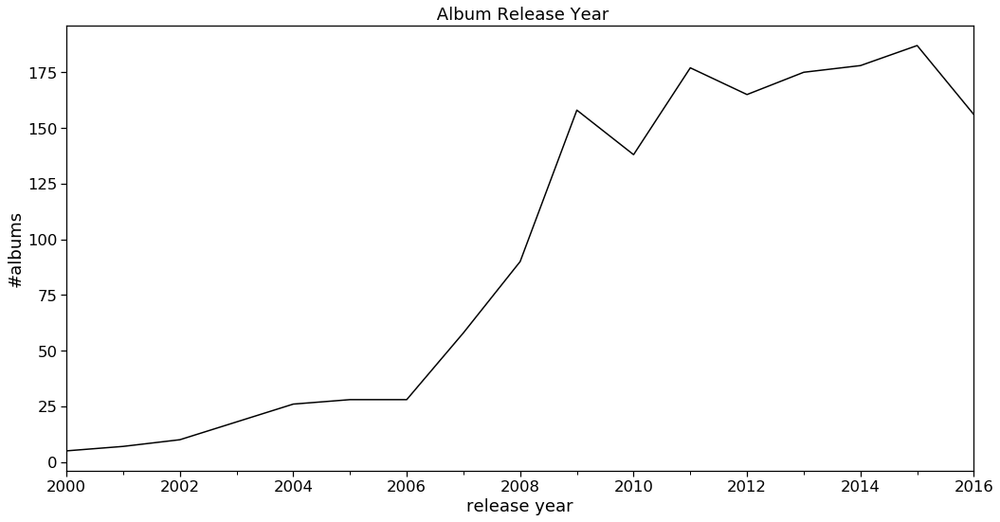

In [70]:
# Same as above, formated for the paper.
plt.figure(figsize=(15, 8))
d = tracks['album'].drop_duplicates('id')
d = pd.Series(1, index=d['date_released'])
d = d.resample('A').sum().fillna(0)
b = d.index >= pd.to_datetime(2000, format='%Y')
b &= d.index <= pd.to_datetime(2017, format='%Y')
d[b].plot(color='k')
plt.title(' Album Release Year')
plt.xlabel('release year')
plt.ylabel('#albums')
plt.tight_layout()
plt.savefig('../figures/album_release_year.pdf')

d.index.min().year, d.index.max().year

In [217]:
newtracks.columns

Index(['bit_rate', 'comments', 'composer', 'date_created', 'date_recorded',
       'duration', 'favorites', 'genre_top', 'genres', 'genres_all',
       'information', 'interest', 'language_code', 'license', 'listens',
       'lyricist', 'number', 'publisher', 'tags', 'title'],
      dtype='object')

In [222]:
recorded = newtracks.set_index('date_created')

In [223]:
recorded.columns

Index(['bit_rate', 'comments', 'composer', 'date_recorded', 'duration',
       'favorites', 'genre_top', 'genres', 'genres_all', 'information',
       'interest', 'language_code', 'license', 'listens', 'lyricist', 'number',
       'publisher', 'tags', 'title'],
      dtype='object')

In [226]:
recorded = recorded[['genre_top']]

In [228]:
recorded = newtracks[['genre_top','date_created']]

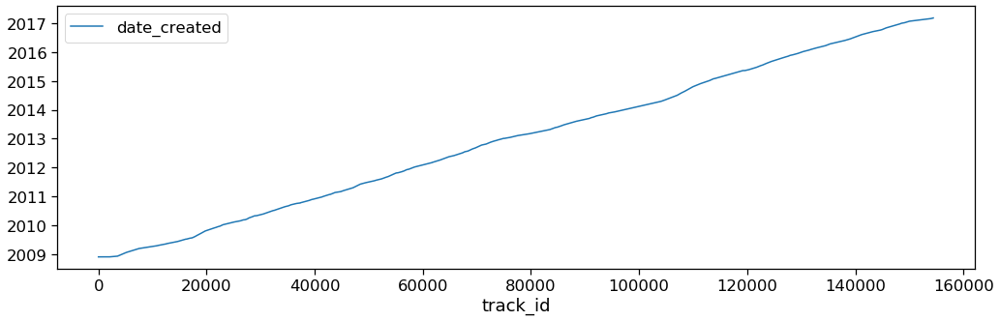

In [230]:
recorded.loc[recorded['genre_top']=='Pop'].plot()

# Artist and album effect

In [324]:
tracks['track', 'genre_top']

track_id
2         Hip-Hop
5         Hip-Hop
10            Pop
140          Folk
141          Folk
           ...   
154308    Hip-Hop
154309    Hip-Hop
154413        Pop
154414        Pop
155066    Hip-Hop
Name: (track, genre_top), Length: 8000, dtype: category
Categories (8, object): [Electronic, Experimental, Folk, Hip-Hop, Instrumental, International, Pop, Rock]

In [328]:
tracks['artist', 'id']

track_id
2             1
5             1
10            6
140          54
141          54
          ...  
154308    23208
154309    23208
154413    24252
154414    24252
155066    22573
Name: (artist, id), Length: 8000, dtype: int64

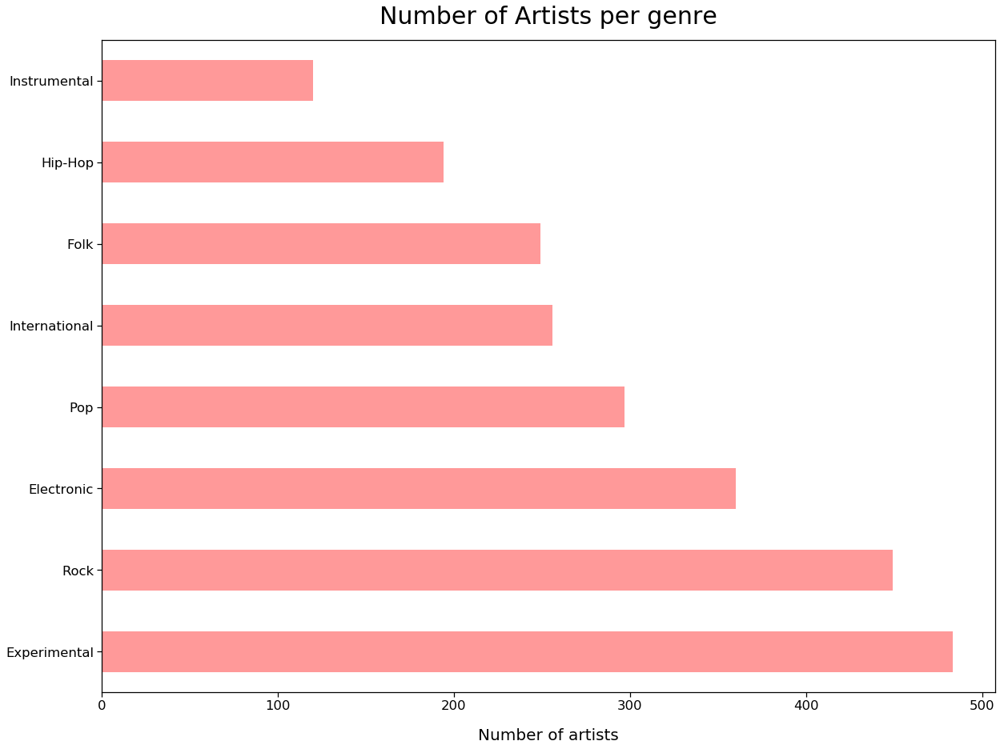

In [332]:
counts = pd.Series(index=genres.loc[genres['parent'] == 0, 'title'].values, name='#artists')
for genre in counts.index:
    counts[genre] = len(tracks.loc[tracks['track', 'genre_top'] == genre, ('artist', 'id')].unique())

counts.sort_values(ascending=False).plot.barh(figsize=(20,15),color='r',alpha=0.4)
plt.title("Number of Artists per genre",size=30,pad=20)
plt.xlabel('Number of artists',size=20,labelpad=20);

In [333]:
counts.sort_values(ascending=False)

Experimental     483.0
Rock             449.0
Electronic       360.0
Pop              297.0
International    256.0
Folk             249.0
Hip-Hop          194.0
Instrumental     120.0
Name: #artists, dtype: float64

# Genre Exploration

In [287]:
genres

,genre_id,#tracks,parent,title,top_level
0,2,5271,0,International,2
1,10,13845,0,Pop,10
2,12,32923,0,Rock,12
3,15,34413,0,Electronic,15
4,17,12706,0,Folk,17
5,21,8389,0,Hip-Hop,21
6,38,38154,0,Experimental,38
7,1235,14938,0,Instrumental,1235


In [ ]:
color = 'r',alpha=0.4,orient='h'

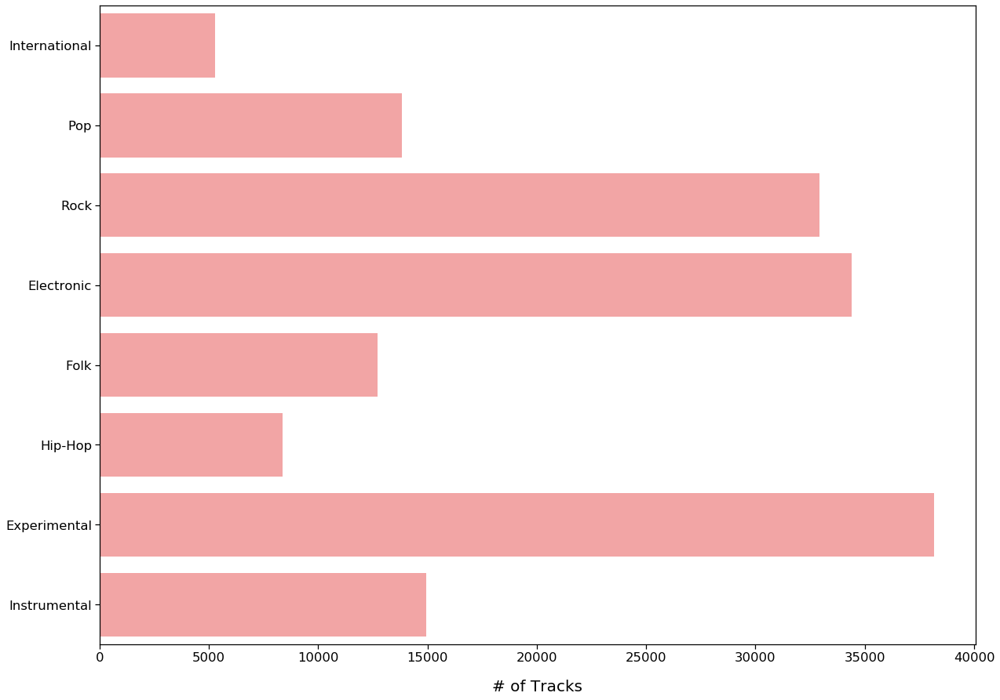

In [321]:
plt.figure(figsize=(20,15))
sns.barplot(y='title',x='#tracks',data=genres,color='r',alpha=0.4,orient='h')
plt.ylabel("")
plt.xlabel("# of Tracks",size=20,labelpad=20)
plt.show()

# Compare Spectogram from 8 different Genres

In [64]:
tracks['track','genre_top'].value_counts()

Rock             1000
Pop              1000
International    1000
Instrumental     1000
Hip-Hop          1000
Folk             1000
Experimental     1000
Electronic       1000
Name: (track, genre_top), dtype: int64

### Rock

In [65]:
tracks.loc[tracks['track','genre_top']=='Rock'].head(1)

album                                                           \
         comments        date_created date_released engineer favorites  id   
track_id                                                                     
182             0 2008-11-26 01:52:18    2005-04-26      NaN         0  80   

                                                                              \
                                                information listens producer   
track_id                                                                       
182       <p><em>Worn Copy</em> is    the history of pop...    5289      NaN   

               ...                                              track          \
         tags  ...                                            license listens   
track_id       ...                                                              
182        []  ...  Attribution-Noncommercial-No Derivative Works ...    5547   

                                                                \
         lyricist number publisher tags                  title   
track_id                                                         
182           NaN      3       NaN   []  Jules Lost His Jewels   

                      subset               genre        testtrainval  
         Unnamed: 53_level_1 Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                                              
182                    small                Rock                test  

[1 rows x 55 columns]

In [66]:
filename = '../data/music/000182.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)



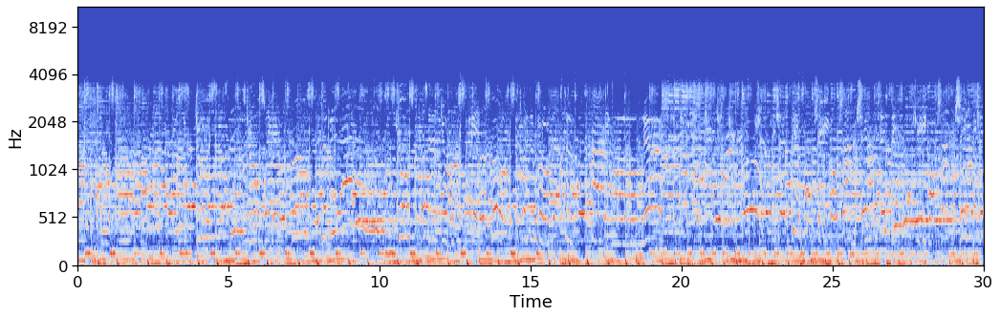

In [67]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### Pop

In [68]:
tracks.loc[tracks['track','genre_top']=='Pop'].head(1)

album                                                          \
         comments        date_created date_released engineer favorites id   
track_id                                                                    
10              0 2008-11-26 01:45:08    2008-02-06      NaN         4  6   

                                            ...  \
         information listens producer tags  ...   
track_id                                    ...   
10               NaN   47632      NaN   []  ...   

                                                      track                   \
                                                    license listens lyricist   
track_id                                                                       
10        Attribution-NonCommercial-NoDerivatives (aka M...   50135      NaN   

                                                     subset  \
         number publisher tags    title Unnamed: 53_level_1   
track_id                                                      
10            1       NaN   []  Freeway               small   

                       genre        testtrainval  
         Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                          
10                       Pop            training  

[1 rows x 55 columns]

In [69]:
filename = '../data/music/000010.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


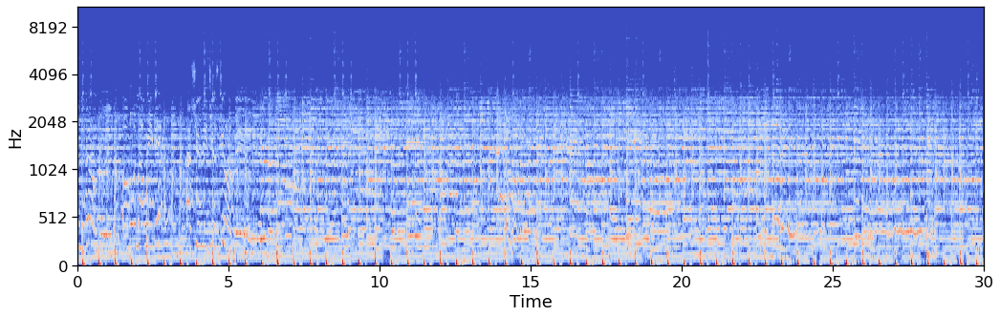

In [70]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### Instrumental 

In [71]:
tracks.loc[tracks['track','genre_top']=='Instrumental'].head(1)

album                                                             \
         comments        date_created date_released engineer favorites    id   
track_id                                                                       
10250           0 2009-04-09 07:19:43           NaT      NaN         0  2524   

                                            ...  \
         information listens producer tags  ...   
track_id                                    ...   
10250            NaN   16695      NaN   []  ...   

                                                      track                   \
                                                    license listens lyricist   
track_id                                                                       
10250     Attribution-Noncommercial-No Derivative Works ...    6577      NaN   

                                                           subset  \
         number publisher tags          title Unnamed: 53_level_1   
track_id                                                            
10250         0       NaN   []  Tree Symphony               small   

                       genre        testtrainval  
         Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                          
10250           Instrumental                test  

[1 rows x 55 columns]

In [72]:
filename = '../data/music/010250.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0,30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


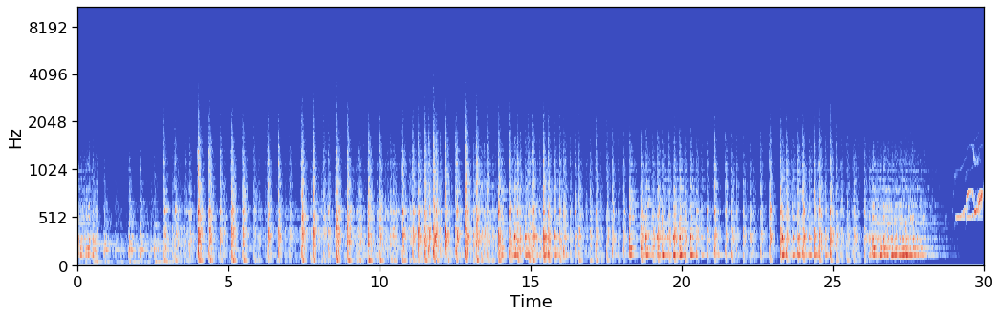

In [73]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### International

In [74]:
tracks.loc[tracks['track','genre_top']=='International'].head(1)

album                                                            \
         comments        date_created date_released engineer favorites   id   
track_id                                                                      
666             0 2008-11-26 02:14:43    2009-01-08      NaN         1  189   

                                                                              \
                                                information listens producer   
track_id                                                                       
666       <p>2 unreleased mp3s from Portland, OR's all-f...    3883      NaN   

               ...                                              track          \
         tags  ...                                            license listens   
track_id       ...                                                              
666        []  ...  Attribution-NonCommercial-ShareAlike 3.0 Inter...    1902   

                                                           subset  \
         lyricist number publisher tags title Unnamed: 53_level_1   
track_id                                                            
666           NaN      0       NaN   []  Heat               small   

                       genre        testtrainval  
         Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                          
666            International            training  

[1 rows x 55 columns]

In [75]:
filename = '../data/music/000666.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


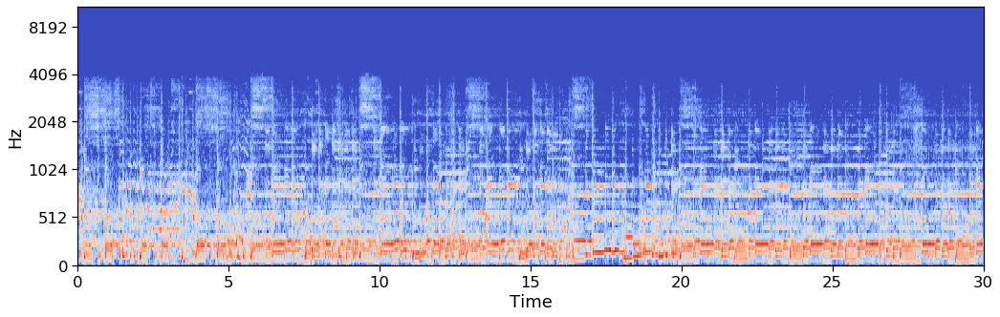

In [76]:
stft = np.abs(librosa.stft(x))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### Hip-Hop

In [77]:
tracks.loc[tracks['track','genre_top']=='Hip-Hop'].head(1)

album                                                          \
         comments        date_created date_released engineer favorites id   
track_id                                                                    
2               0 2008-11-26 01:44:45    2009-01-05      NaN         4  1   

                                            ...  \
         information listens producer tags  ...   
track_id                                    ...   
2            <p></p>    6073      NaN   []  ...   

                                                      track                   \
                                                    license listens lyricist   
track_id                                                                       
2         Attribution-NonCommercial-ShareAlike 3.0 Inter...    1293      NaN   

                                                  subset               genre  \
         number publisher tags title Unnamed: 53_level_1 Unnamed: 54_level_1   
track_id                                                                       
2             3       NaN   []  Food               small             Hip-Hop   

                testtrainval  
         Unnamed: 55_level_1  
track_id                      
2                   training  

[1 rows x 55 columns]

In [78]:
filename = '../data/music/000002.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


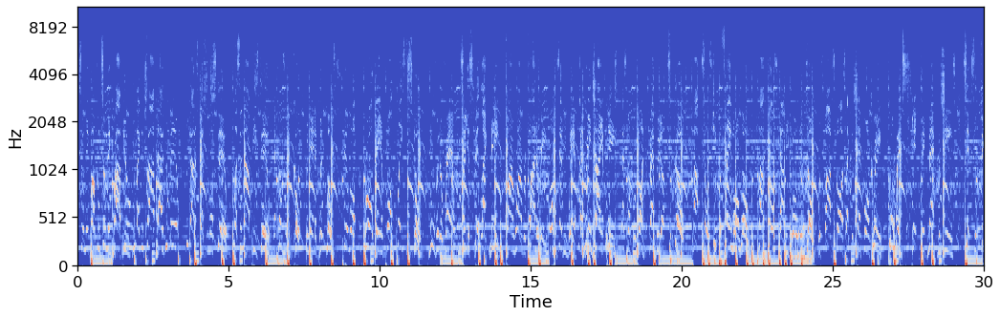

In [79]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### Folk

In [80]:
tracks.loc[tracks['track','genre_top']=='Folk'].head(1)

album                                                           \
         comments        date_created date_released engineer favorites  id   
track_id                                                                     
140             1 2008-11-26 01:49:59    2007-05-22      NaN         1  61   

                                                                     \
                                                information listens   
track_id                                                              
140       <p>Alec K. Redfearn &amp; The Eyesores: Ellen ...    1300   

                                               ...  \
                                producer tags  ...   
track_id                                       ...   
140       Alec K. Refearn, Rob Pemberton   []  ...   

                                                      track                   \
                                                    license listens lyricist   
track_id                                                                       
140       Attribution-Noncommercial-No Derivative Works ...    1299      NaN   

                                                                subset  \
         number publisher tags               title Unnamed: 53_level_1   
track_id                                                                 
140           2       NaN   []  Queen Of The Wires               small   

                       genre        testtrainval  
         Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                          
140                     Folk            training  

[1 rows x 55 columns]

In [81]:
filename = '../data/music/000140.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 10
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


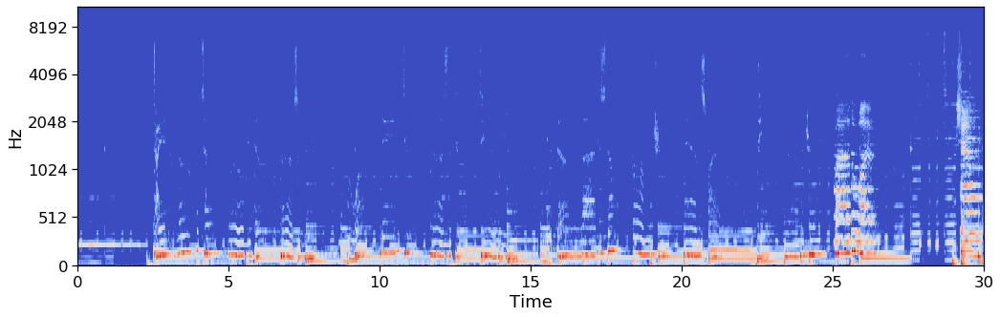

In [82]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### Experimental

In [83]:
tracks.loc[tracks['track','genre_top']=='Experimental'].head(1)

album                                                           \
         comments        date_created date_released engineer favorites  id   
track_id                                                                     
148             0 2008-11-26 01:50:19    2009-01-15      NaN         0  66   

                                                                              \
                                                information listens producer   
track_id                                                                       
148       <p>"Compositions for electronics and voice." I...    1831      NaN   

               ...                                              track          \
         tags  ...                                            license listens   
track_id       ...                                                              
148        []  ...  Attribution-Noncommercial-Share Alike 3.0 Unit...    1831   

                                                                 subset  \
         lyricist number publisher tags       title Unnamed: 53_level_1   
track_id                                                                  
148           NaN      2       NaN   []  Blackout 2               small   

                       genre        testtrainval  
         Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                          
148             Experimental          validation  

[1 rows x 55 columns]

In [84]:
filename = '../data/music/000148.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


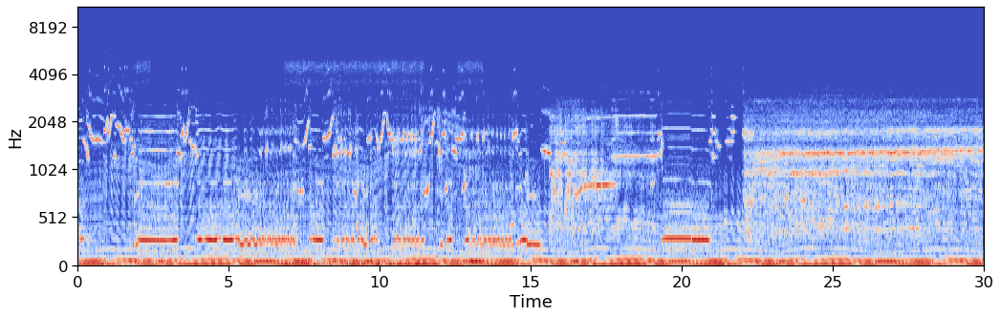

In [85]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');

### Electronic

In [86]:
tracks.loc[tracks['track','genre_top']=='Electronic'].head(2)

album                                                           \
         comments        date_created date_released     engineer favorites   
track_id                                                                     
1482            0 2008-11-26 02:58:24    2009-01-16          NaN         0   
3573            0 2008-12-04 09:27:42    2003-07-23  Jason Engel         2   

                                                                           \
            id                                        information listens   
track_id                                                                    
1482       389  <p>Self-released tape recorded Alfred, NY and ...   61609   
3573      1141  <p>Dan Deacon from Purchase, NY came down with...   35157   

                        ...  \
         producer tags  ...   
track_id                ...   
1482          NaN   []  ...   
3573         OCDJ   []  ...   

                                                      track                   \
                                                    license listens lyricist   
track_id                                                                       
1482      Attribution-Noncommercial-Share Alike 3.0 Unit...   77299      NaN   
3573      Attribution-NonCommercial-ShareAlike 3.0 Inter...    6678      NaN   

                                                            subset  \
         number publisher tags           title Unnamed: 53_level_1   
track_id                                                             
1482          2       NaN   []  Reindeer Dance               small   
3573         19       NaN   []         Piggled               small   

                       genre        testtrainval  
         Unnamed: 54_level_1 Unnamed: 55_level_1  
track_id                                          
1482              Electronic            training  
3573              Electronic            training  

[2 rows x 55 columns]

In [87]:
filename = '../data/music/001482.mp3'
x, sr = librosa.load(filename, sr=None, mono=True)
start, end = 0, 30
ipd.Audio(data=x[start*sr:end*sr], rate=sr)


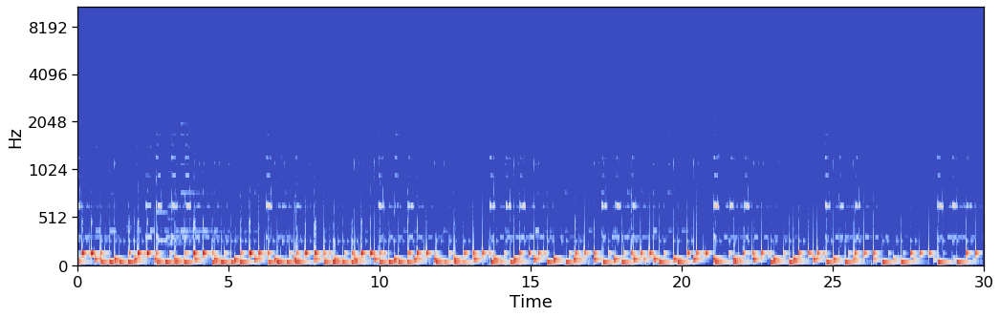

In [88]:
stft = np.abs(librosa.stft(x, n_fft=2048, hop_length=512))
mel = librosa.feature.melspectrogram(sr=sr, S=stft**2)
log_mel = librosa.amplitude_to_db(mel)
librosa.display.specshow(log_mel, sr=sr, hop_length=512, x_axis='time', y_axis='mel');